# Reading Multi Spectral Images

https://nbviewer.jupyter.org/github/thomasaarholt/hyperspy-demos/blob/master/2_SVD_and_BSS.ipynb

## Bands and Wavelengths
When talking about spectral data, we talk from both, the electromagnetic spectrum and image bands. Spectral remote sensing data are collected by powerful camera-like instruments known as imaging spectrometers. Imaging spectrometers collect reflected light energy in “bands.”

A band represents a segment of the electromagnetic spectrum. For example, the wavelength values between 800 nanometers (nm) and 850 nm might be one band captured by an imaging spectrometer. The imaging spectrometer collects reflected light energy within a pixel area on the ground. Since an imaging spectrometer collects many different types of light - for each pixel the amount of light energy for each type of light or band will be recorded. So, for example, a camera records the amount of red, green and blue light for each pixel.

Often when we work with a multispectral dataset, the band information is reported as the center wavelength value. This value represents the center point value of the wavelengths represented in that band. Thus in a band spanning 800-850 nm, the center would be 825 nm.

## Spectral Resolution
The spectral resolution of a dataset that has more than one band, refers to the spectral width of each band in the dataset. While a general spectral resolution of the sensor is often provided, not all sensors collect information within bands of uniform widths.

## Spatial Resolution
The spatial resolution of a raster represents the area on the ground that each pixel covers. If you have smaller pixels in a raster the data will appear more “detailed.” If you have large pixels in a raster, the data will appear more coarse or “fuzzy.”


## Multispectral Imagery
Images obtained with a ADC Lite - Tetracam's Lightweight ADC

I made pitures about: 

>Aluminum , Copper, Brass, Iron, Stainless Steel, Painted Iron 

http://tetracam.com/Products-ADC_Lite.htm

MRobalinho - 23-03-2019

In [2]:
# Some libraries
import glob, os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image
from openpyxl import load_workbook

In [3]:
# Verify my current folder
currDir = os.path.dirname(os.path.realpath("__file__"))
mypath = currDir
print(currDir)  

C:\Users\manuel.robalinho\Google Drive\UPT_Portucalense\Trabalho final\Classificacao Sucata\Jupyter_Notebook


In [4]:
# Path to the image files
folder = "imagedata03"
path = currDir + "/" + folder + "/"

# Part name of file to filter files
end_file = "_1.jpg"

In [5]:
# Read files from folder
print(' ---- IMAGES ON THE FOLDER -------')
for file in os.listdir(path):
    if file.endswith(end_file):
        print(os.path.join(file))

 ---- IMAGES ON THE FOLDER -------
Aluminum_1.jpg
Brass_1.jpg
CopperWire_1.jpg
Copper_1.jpg
Iron_1.jpg
PaintedIron_1.jpg
StainlessSteel_1.jpg


In [6]:
# Create Data Frame with image information
df_image = []

In [7]:
# Look from an chanel from then image

def channel(img, n):
    """Isolate the nth channel from the image.

       n = 0: red, 1: green, 2: blue
    """
    a = np.array(img)
    a[:,:,(n!=0, n!=1, n!=2)] *= 0
#    a[:,:,n] *= 0
    print(Image.fromarray(a), 'Get Channel n: ', n)
  
    return Image.fromarray(a)

# def to resize 
# Given parameters : image , number to divide (resize)
def imageResize(img, n):
    width, height = img.size 

    print('Original size:', width, '/', height, 'Resize:',n)
    
    newWidth = int(width / n)
    newHeight = int(height / n)
    img.resize((newWidth, newHeight), Image.ANTIALIAS)
    print('New size:', newWidth, '/', newHeight)
    return img

In [8]:
def print_file(path, xfile):
  print('------------------------------------------------------------------------')   
  tif_f1 = Image.open(path+xfile)
    
  # Transform Image to array
  aArray = np.array(tif_f1)
  # Array sum  
  xsum = aArray.sum() / 1000000
    
  # Get channel 0
  x0_channel = channel(tif_f1, 0)
  aArray = np.array(x0_channel)
  xsum_0 = aArray.sum() / 1000000  
    
  # Get channel 1
  x1_channel = channel(tif_f1, 1)
  aArray = np.array(x1_channel)
  xsum_1 = aArray.sum() / 1000000  
         
  # Get channel 2
  x2_channel = channel(tif_f1, 2)
  aArray = np.array(x2_channel)
  xsum_2 = aArray.sum() / 1000000  

  # Histogram from image
  aHist = tif_f1.histogram()
  hsum = sum(aHist) / 100000

  # Histogram channel 0
  aHist_0 = x0_channel.histogram()
  hsum_0 = sum(aHist_0) / 100000

  # Histogram channel 1
  aHist_1 = x1_channel.histogram()
  hsum_1 = sum(aHist_1) / 100000
  
  # Histogram chanel 0
  aHist_2 = x2_channel.histogram()
  hsum_2 = sum(aHist_2) / 100000
 
  # number elements on list
  nlist = len(aHist)
    
  # Get color
  pix_val = list(tif_f1.getdata())
  # Transform tuple in a list
  pix_val_flat = [x for sets in pix_val for x in sets]
  # Sum the list and medium list pixel
  sum_pix = sum(pix_val_flat)
  med_pix = sum_pix / len(pix_val_flat)

  # Obtain name file without extension 
  sample_name = os.path.basename(xfile).split('_')[0]
 
  # Print information  
  print('Inf.File:',xfile , sample_name,' Size:',tif_f1.size, ' Format:',tif_f1.format, ' Mode:', tif_f1.mode)
  # More information image
  print('         ',' Bands Extrems:',tif_f1.getextrema())
  # More information image
  print('         ',' Sum array:',xsum, ' Sum Ch 0:', xsum_0, ' Sum Ch 1:', xsum_1, ' Sum Ch 2:', xsum_2)      
  # More information image
  print('         ',' Histog:', hsum ,' Histog Ch0:', hsum_0,' Histog Ch1:', hsum_1,' Histog Ch2:', hsum_2, '  N.List elem:', nlist)
  print('         ',' Color:', med_pix)  
  # insert information in a Pandas Data Frame
  df_image.append((folder, xfile, sample_name, tif_f1.size, tif_f1.format, tif_f1.mode ,tif_f1.getextrema(), 
                   xsum, xsum_0, xsum_1, xsum_2, hsum, hsum_0,hsum_1,hsum_2, nlist, med_pix))  

In [9]:
# Create Data Frame with image information
df_image = []

xend_file = "*" + end_file
os.chdir(path)
for file in glob.glob(xend_file):
 #   print(file)
    print_file(path,file)

------------------------------------------------------------------------
<PIL.Image.Image image mode=RGB size=5312x2988 at 0x274FB8007F0> Get Channel n:  0
<PIL.Image.Image image mode=RGB size=5312x2988 at 0x274FB8007F0> Get Channel n:  1
<PIL.Image.Image image mode=RGB size=5312x2988 at 0x274FB8007F0> Get Channel n:  2
Inf.File: Aluminum_1.jpg Aluminum  Size: (5312, 2988)  Format: JPEG  Mode: RGB
           Bands Extrems: ((0, 255), (0, 255), (9, 255))
           Sum array: 3487.099309  Sum Ch 0: 2614.556834  Sum Ch 1: 2600.402524  Sum Ch 2: 2567.107247
           Histog: 476.16768  Histog Ch0: 476.16768  Histog Ch1: 476.16768  Histog Ch2: 476.16768   N.List elem: 768
           Color: 163.4312224844828
------------------------------------------------------------------------
<PIL.Image.Image image mode=RGB size=5312x2988 at 0x274FB800710> Get Channel n:  0
<PIL.Image.Image image mode=RGB size=5312x2988 at 0x274FB8004E0> Get Channel n:  1
<PIL.Image.Image image mode=RGB size=5312x2988 

In [14]:
df = pd.DataFrame(df_image,columns=['Folder','File','Material','Size','Format','Mode','Bands Extrems',
                                    'Array_sum', 'Sum_Ch0','Sum_Ch1','Sum_Ch2',
                                    'Histogram','Hist_Ch0','Hist_Ch1','Hist_Ch2','Number_list_elements','Color'])
df.head()

,Folder,File,Material,Size,Format,Mode,Bands Extrems,Array_sum,Sum_Ch0,Sum_Ch1,Sum_Ch2,Histogram,Hist_Ch0,Hist_Ch1,Hist_Ch2,Number_list_elements,Color
0,imagedata03,Aluminum_1.jpg,Aluminum,"(5312, 2988)",JPEG,RGB,"((0, 255), (0, 255), (9, 255))",3487.099309,2614.556834,2600.402524,2567.107247,476.16768,476.16768,476.16768,476.16768,768,163.431222
1,imagedata03,Brass_1.jpg,Brass,"(5312, 2988)",JPEG,RGB,"((14, 255), (6, 255), (0, 255))",3351.352573,2626.345572,2553.685796,2466.288501,476.16768,476.16768,476.16768,476.16768,768,160.580405
2,imagedata03,CopperWire_1.jpg,CopperWire,"(5312, 2988)",JPEG,RGB,"((0, 255), (0, 255), (0, 255))",2595.753222,2314.445608,2313.038337,2263.236573,476.16768,476.16768,476.16768,476.16768,768,144.712059
3,imagedata03,Copper_1.jpg,Copper,"(5312, 2988)",JPEG,RGB,"((35, 255), (17, 255), (6, 255))",3400.502407,2731.080699,2549.470157,2414.918847,476.16768,476.16768,476.16768,476.16768,768,161.612600
4,imagedata03,Iron_1.jpg,Iron,"(5312, 2988)",JPEG,RGB,"((12, 255), (23, 255), (21, 255))",2829.021121,2388.854306,2389.478945,2345.655166,476.16768,476.16768,476.16768,476.16768,768,149.610919


In [15]:
# Verify my current folder
path = mypath + r"/upt_data.xlsx"
print('Write statistics into file :', path)

# Block to Read excel old excel file
book = load_workbook(path)
writer = pd.ExcelWriter(path, engine = 'openpyxl')
writer.book = book
# ------------------------

# Write statistics into excel file
#writer = pd.ExcelWriter(path, engine = 'xlsxwriter') # only for new excelfile
df.to_excel(writer, sheet_name = folder)
writer.save()
writer.close()

Write statistics into file : C:\Users\manuel.robalinho\Google Drive\UPT_Portucalense\Trabalho final\Classificacao Sucata\Jupyter_Notebook/upt_data.xlsx


In [22]:
df_plot = pd.DataFrame(df, columns=["Material", "Array_sum", "Sum_Ch0", "Sum_Ch1", "Sum_Ch2","Color"])
df_plot


,Material,Array_sum,Sum_Ch0,Sum_Ch1,Sum_Ch2,Color
0,Aluminum,3487.099309,2614.556834,2600.402524,2567.107247,163.431222
1,Brass,3351.352573,2626.345572,2553.685796,2466.288501,160.580405
2,CopperWire,2595.753222,2314.445608,2313.038337,2263.236573,144.712059
3,Copper,3400.502407,2731.080699,2549.470157,2414.918847,161.612600
4,Iron,2829.021121,2388.854306,2389.478945,2345.655166,149.610919
5,PaintedIron,168.784754,2928.383094,2929.999542,2900.336710,183.941912
6,StainlessSteel,3822.686116,2716.611880,2710.099422,2690.942110,170.478883


In [23]:
df_plot.Sum_Ch0 = df_plot.Sum_Ch0 + 100 # to have diference lines during plot
df_plot.Sum_Ch1 = df_plot.Sum_Ch1 + 200
df_plot.Sum_Ch2 = df_plot.Sum_Ch2 + 300
df_plot.Color  = df_plot.Color * 10
df_plot

,Material,Array_sum,Sum_Ch0,Sum_Ch1,Sum_Ch2,Color
0,Aluminum,3487.099309,2714.556834,2800.402524,2867.107247,1634.312225
1,Brass,3351.352573,2726.345572,2753.685796,2766.288501,1605.804046
2,CopperWire,2595.753222,2414.445608,2513.038337,2563.236573,1447.120585
3,Copper,3400.502407,2831.080699,2749.470157,2714.918847,1616.126005
4,Iron,2829.021121,2488.854306,2589.478945,2645.655166,1496.109189
5,PaintedIron,168.784754,3028.383094,3129.999542,3200.336710,1839.419119
6,StainlessSteel,3822.686116,2816.611880,2910.099422,2990.942110,1704.788828


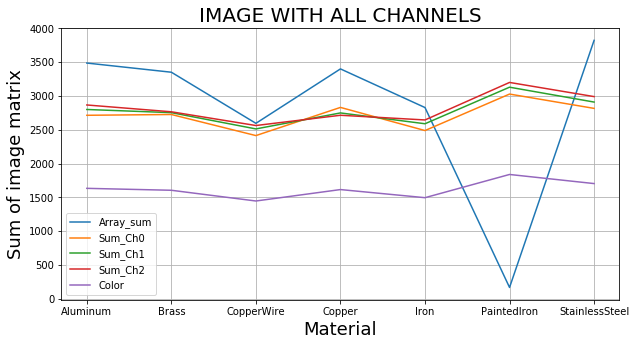

In [24]:
df_plot.plot(y=["Array_sum","Sum_Ch0","Sum_Ch1", "Sum_Ch2","Color"],figsize=(10,5), grid=True )

# Obtain legend (xticks) for X axis
loc_Array_sum = np.arange(len(df_plot.index))
# Position of X labels
xtick_loc = list(loc_Array_sum)  
# Name of x labels
xticks = list(df_plot.Material)
#-------

#plt.plot(df_plot.Array_sum)
plt.title('IMAGE WITH ALL CHANNELS',fontsize=20)
plt.ylabel('Sum of image matrix',fontsize=18)
plt.xticks(xtick_loc, df_plot.Material, rotation=0)
plt.xlabel('Material',fontsize=18)
plt.show()

In [25]:
# Create pivot table
df_plot1 = df_plot.groupby('Material')['Array_sum', 'Sum_Ch0','Sum_Ch1','Sum_Ch2','Color'].mean()
df_plot1

,Array_sum,Sum_Ch0,Sum_Ch1,Sum_Ch2,Color
Material,,,,,
Aluminum,3487.099309,2714.556834,2800.402524,2867.107247,1634.312225
Brass,3351.352573,2726.345572,2753.685796,2766.288501,1605.804046
Copper,3400.502407,2831.080699,2749.470157,2714.918847,1616.126005
CopperWire,2595.753222,2414.445608,2513.038337,2563.236573,1447.120585
Iron,2829.021121,2488.854306,2589.478945,2645.655166,1496.109189
PaintedIron,168.784754,3028.383094,3129.999542,3200.336710,1839.419119
StainlessSteel,3822.686116,2816.611880,2910.099422,2990.942110,1704.788828


In [26]:
df = pd.DataFrame(df_plot1.Array_sum)   
color = ['red','blue','green','orange','cyan','black']

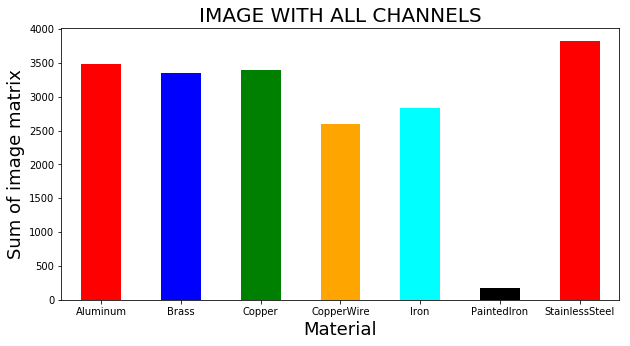

In [27]:
df.plot(kind='bar', y=0, color=color, legend=False, rot=0, figsize=(10,5))
plt.title('IMAGE WITH ALL CHANNELS',fontsize=20)
plt.xlabel('Material',fontsize=18)
plt.ylabel('Sum of image matrix',fontsize=18)
plt.show()

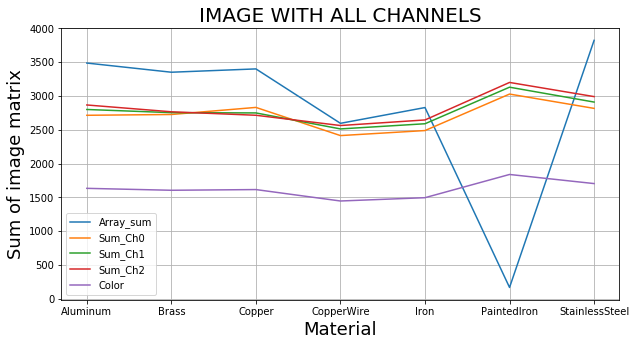

In [28]:
loc_Array_sum = np.arange(len(df_plot1.index))
xtick_loc = list(loc_Array_sum)  
xticks = list(df_plot1.index)

df_plot1.plot( y=["Array_sum","Sum_Ch0","Sum_Ch1", "Sum_Ch2","Color"],figsize=(10,5), grid=True )
plt.xticks(xtick_loc, df_plot1.index, rotation=0)
plt.title('IMAGE WITH ALL CHANNELS',fontsize=20)
plt.xlabel('Material',fontsize=18)
plt.ylabel('Sum of image matrix',fontsize=18)
plt.show()

In [29]:
loc_Array_sum = np.arange(len(df_plot1.index))+0.1 # Offsetting the tick-label location
loc_r = np.arange(len(df_plot1.index))-0.1 # Offsetting the tick-label location
loc_g = np.arange(len(df_plot1.index))-0.3 # Offsetting the tick-label location
loc_b = np.arange(len(df_plot1.index))-0.5 # Offsetting the tick-label location

xtick_loc = list(loc_g)  
xticks = list(df_plot1.index)

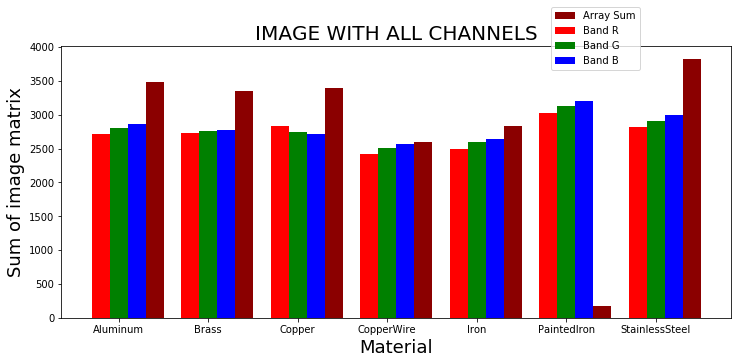

In [30]:
#Plot  Bar Graph
#df_plot1.plot(kind='bar', figsize=(12,5), grid=True, color='darkred',fontsize=18)
loc_Array_sum = np.arange(len(df_plot1.index))+0.1 # Offsetting the tick-label location
loc_b = np.arange(len(df_plot1.index))-0.1 # Offsetting the tick-label location
loc_g = np.arange(len(df_plot1.index))-0.3 # Offsetting the tick-label location
loc_r = np.arange(len(df_plot1.index))-0.5 # Offsetting the tick-label location

#xtick_loc = list(loc_Array_sum) + list(loc_r) + list(loc_g) + list(loc_b)
#xticks = list(selected.keys())+ list(rejected.keys())
colors = ['darkred','red','green','blue','orange','cyan','black']
plt.figure(figsize=(12,5))

plt.bar(loc_Array_sum, df_plot1.Array_sum, color=colors[0], width=0.2, label='Array Sum')
plt.bar(loc_r, df_plot1.Sum_Ch0, color=colors[1], width=0.2,label='Band R')
plt.bar(loc_g, df_plot1.Sum_Ch1, color=colors[2], width=0.2,label='Band G')
plt.bar(loc_b, df_plot1.Sum_Ch2, color=colors[3], width=0.2,label='Band B')

plt.title('IMAGE WITH ALL CHANNELS',fontsize=20)
plt.xlabel('Material',fontsize=18)
plt.ylabel('Sum of image matrix',fontsize=18)
plt.xticks(xtick_loc, xticks, rotation=0)
plt.legend(bbox_to_anchor=(.8,0.8),\
    bbox_transform=plt.gcf().transFigure)

plt.show()

<Figure size 432x288 with 0 Axes>

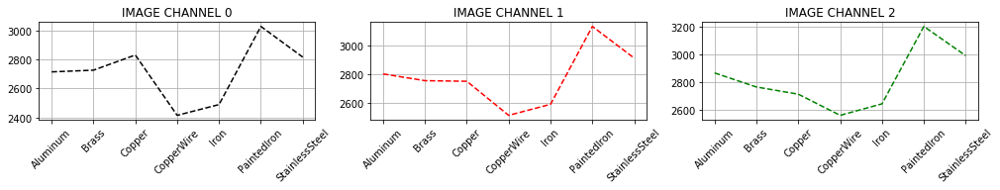

In [31]:
plt.figure(1)
plt.figure(figsize=(17, 4))
plt.tight_layout()
plt.subplot(231)
plt.title('IMAGE CHANNEL 0')
plt.xticks(rotation=45)
plt.grid(True)
plt.plot(df_plot1.Sum_Ch0, 'k--')

plt.subplot(232)
plt.title('IMAGE CHANNEL 1')
plt.xticks(rotation=45)
plt.grid(True)
plt.plot(df_plot1.Sum_Ch1,  'r--')

plt.subplot(233)
plt.title('IMAGE CHANNEL 2')
plt.xticks(rotation=45)
plt.plot(df_plot1.Sum_Ch2,  'g--')
plt.grid(True)
plt.show()

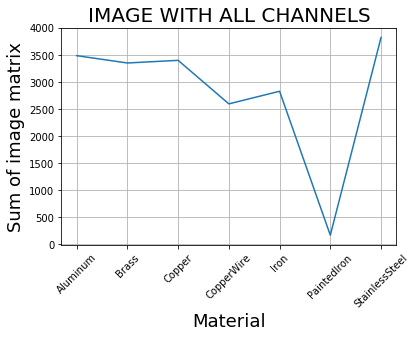

In [32]:
# Plot channel based
plt.plot(df_plot1.Array_sum)
plt.title('IMAGE WITH ALL CHANNELS',fontsize=20)
plt.xlabel('Material',fontsize=18)
plt.ylabel('Sum of image matrix',fontsize=18)
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

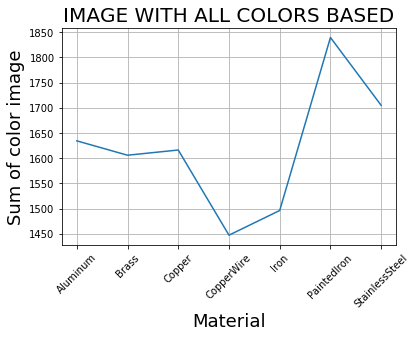

In [33]:
# Plot based on color
plt.plot(df_plot1.Color)
plt.title('IMAGE WITH COLORS BASED',fontsize=20)
plt.xlabel('Material',fontsize=18)
plt.ylabel('Sum of color image',fontsize=18)
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

# Using PIL to read images


In [17]:
# Read TIFF Image
from PIL import Image

f1_alum = 'Aluminum_1.TIF'
tif_f1_alum = Image.open(f1_alum)
#
#print('File name:',f1_alum , '     Size File:',tif_f1_alum.size, '    Format file:',tif_f1_alum.format)


In [18]:
# Print Bands from image
tif_f1_alum.getbands()

('R', 'G', 'B')

In [19]:
# Display extrems from each band
def print_bands(path, xfile):
    tif_f1 = Image.open(path+xfile)
    print('Bands Extrems from File name:',xfile ,tif_f1.getextrema())    

In [20]:
# Read files from folder - ALUMINUM
os.chdir(path)
for file in glob.glob("*.tif"):
 #   print(file)
    print_bands(path,file)

Bands Extrems from File name: Aluminum_1.TIF ((2, 255), (2, 255), (1, 255))
Bands Extrems from File name: Aluminum_2.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Aluminum_3.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Brass_1.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Brass_2.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Brass_3.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Brass_4.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Brass_5.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: CooperWire_1.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: CooperWire_2.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Copper_1.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Copper_2.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name: Copper_3.TIF ((1, 255), (1, 255), (0, 255))
Bands Extrems from File name:

In [104]:
print(tif_f1_alum.getcolors())

None


In [105]:
# Transform Image to array
aArray = np.array(tif_f1_alum)
#aArray = np.array(x0_channel)
#a[:,:,0] *=0
#a[:,:,1] *=0

# Transform array to Image
cImage = Image.fromarray(aArray)
aArray 

array([[[27, 27, 26],
        [23, 23, 22],
        [21, 21, 19],
        ...,
        [ 7,  7,  5],
        [13, 13, 11],
        [16, 16, 14]],

       [[27, 27, 26],
        [23, 23, 21],
        [20, 20, 18],
        ...,
        [ 3,  3,  1],
        [ 4,  4,  2],
        [ 6,  6,  5]],

       [[27, 27, 26],
        [23, 23, 21],
        [19, 19, 18],
        ...,
        [ 3,  3,  2],
        [ 3,  3,  2],
        [ 3,  3,  2]],

       ...,

       [[ 8,  8,  7],
        [ 7,  7,  6],
        [ 7,  7,  5],
        ...,
        [13, 13, 11],
        [12, 12, 10],
        [12, 12, 10]],

       [[ 8,  8,  6],
        [ 7,  7,  6],
        [ 8,  8,  6],
        ...,
        [13, 13, 11],
        [13, 13, 11],
        [11, 11, 10]],

       [[ 8,  8,  6],
        [ 8,  8,  6],
        [ 9,  9,  7],
        ...,
        [13, 13, 11],
        [13, 13, 11],
        [12, 12, 11]]], dtype=uint8)

In [106]:
# Transform array to list
matrix = aArray.tolist()
#print("Original array: "+str(matrix))
matrix

[[[27, 27, 26],
  [23, 23, 22],
  [21, 21, 19],
  [20, 20, 18],
  [19, 19, 17],
  [18, 18, 17],
  [17, 17, 15],
  [15, 15, 13],
  [13, 13, 12],
  [12, 12, 11],
  [12, 12, 11],
  [12, 12, 11],
  [23, 23, 21],
  [33, 33, 32],
  [35, 35, 34],
  [37, 37, 36],
  [39, 39, 37],
  [40, 40, 39],
  [41, 41, 40],
  [50, 50, 49],
  [117, 117, 115],
  [211, 211, 209],
  [70, 70, 69],
  [29, 29, 27],
  [24, 24, 22],
  [32, 32, 30],
  [43, 43, 41],
  [41, 41, 39],
  [60, 60, 58],
  [81, 81, 80],
  [95, 95, 94],
  [90, 90, 88],
  [93, 93, 92],
  [84, 84, 82],
  [54, 54, 53],
  [46, 46, 45],
  [54, 54, 52],
  [67, 67, 65],
  [92, 92, 90],
  [140, 140, 139],
  [199, 199, 197],
  [229, 229, 227],
  [221, 221, 219],
  [216, 216, 214],
  [212, 212, 210],
  [209, 209, 207],
  [203, 203, 201],
  [196, 196, 195],
  [191, 191, 189],
  [180, 180, 179],
  [151, 151, 150],
  [119, 119, 117],
  [113, 113, 112],
  [98, 98, 97],
  [71, 71, 69],
  [90, 90, 88],
  [109, 109, 107],
  [117, 117, 115],
  [117, 117, 116],

In [107]:
# Soma do array da imagem
xsum = aArray.sum()
xsum

2917186

<PIL.Image.Image image mode=RGB size=128x96 at 0x21C5E278400> Get Channel n:  0


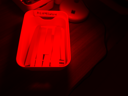

In [108]:
# Get channel 0
x0_channel = channel(cImage, 0)
x0_channel

<PIL.Image.Image image mode=RGB size=128x96 at 0x21C5E278828> Get Channel n:  1


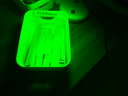

In [109]:
# Get channel 1
x1_channel = channel(cImage, 1)
x1_channel

<PIL.Image.Image image mode=RGB size=128x96 at 0x21C5E278908> Get Channel n:  2


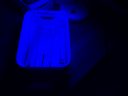

In [110]:
# Get channel 2
x2_channel = channel(cImage, 2)
x2_channel

In [111]:
# Resize Image
aFile = cImage
xFile = imageResize(aFile, 20)
   
          
#Saved in the same relative location 
xFile.save("resized_picture.jpg") 

Original size: 128 / 96 Resize: 20
New size: 6 / 4


In [112]:
print(xFile)

<PIL.Image.Image image mode=RGB size=128x96 at 0x21C5E1389E8>


In [113]:
# Getting histogram of image 
aHistgram = aFile.histogram()
print(aHistgram)

[0, 0, 19, 41, 26, 14, 46, 136, 204, 283, 347, 410, 381, 457, 1342, 665, 332, 200, 187, 189, 171, 106, 103, 83, 88, 66, 78, 68, 74, 77, 111, 71, 113, 83, 81, 74, 82, 72, 61, 63, 59, 61, 57, 48, 33, 37, 49, 61, 48, 39, 57, 50, 53, 51, 48, 61, 47, 61, 48, 45, 38, 39, 36, 28, 29, 22, 21, 29, 27, 24, 32, 24, 25, 23, 24, 19, 29, 24, 16, 25, 24, 27, 22, 26, 39, 23, 17, 22, 21, 16, 24, 16, 15, 20, 16, 21, 10, 16, 15, 10, 20, 14, 12, 13, 7, 15, 9, 11, 6, 16, 7, 4, 11, 7, 8, 5, 9, 9, 10, 10, 4, 11, 8, 8, 6, 3, 7, 5, 6, 8, 7, 5, 6, 5, 4, 4, 5, 8, 4, 7, 5, 4, 7, 8, 9, 9, 4, 4, 8, 3, 4, 10, 6, 3, 6, 6, 5, 8, 5, 4, 5, 4, 8, 1, 6, 1, 8, 8, 5, 3, 8, 4, 3, 3, 2, 3, 7, 7, 7, 10, 8, 2, 10, 5, 4, 4, 11, 7, 5, 4, 4, 6, 8, 9, 6, 9, 7, 7, 9, 8, 9, 8, 8, 9, 9, 9, 13, 15, 8, 11, 8, 28, 23, 15, 24, 18, 20, 18, 22, 30, 24, 29, 36, 29, 31, 31, 37, 21, 21, 35, 25, 44, 35, 31, 43, 41, 39, 62, 46, 43, 55, 60, 59, 57, 52, 57, 63, 61, 56, 51, 56, 63, 65, 68, 73, 755, 0, 0, 19, 41, 26, 14, 46, 136, 204, 283, 347, 410,

In [114]:
print(sum(aHistgram), len(aHistgram))

36864 768


In [82]:
# Getting histogram of image of channel 0 - R
aHist_0= x0_channel.histogram() 
print(aHist_0)

[0, 0, 19, 41, 26, 14, 46, 136, 204, 283, 347, 410, 381, 457, 1342, 665, 332, 200, 187, 189, 171, 106, 103, 83, 88, 66, 78, 68, 74, 77, 111, 71, 113, 83, 81, 74, 82, 72, 61, 63, 59, 61, 57, 48, 33, 37, 49, 61, 48, 39, 57, 50, 53, 51, 48, 61, 47, 61, 48, 45, 38, 39, 36, 28, 29, 22, 21, 29, 27, 24, 32, 24, 25, 23, 24, 19, 29, 24, 16, 25, 24, 27, 22, 26, 39, 23, 17, 22, 21, 16, 24, 16, 15, 20, 16, 21, 10, 16, 15, 10, 20, 14, 12, 13, 7, 15, 9, 11, 6, 16, 7, 4, 11, 7, 8, 5, 9, 9, 10, 10, 4, 11, 8, 8, 6, 3, 7, 5, 6, 8, 7, 5, 6, 5, 4, 4, 5, 8, 4, 7, 5, 4, 7, 8, 9, 9, 4, 4, 8, 3, 4, 10, 6, 3, 6, 6, 5, 8, 5, 4, 5, 4, 8, 1, 6, 1, 8, 8, 5, 3, 8, 4, 3, 3, 2, 3, 7, 7, 7, 10, 8, 2, 10, 5, 4, 4, 11, 7, 5, 4, 4, 6, 8, 9, 6, 9, 7, 7, 9, 8, 9, 8, 8, 9, 9, 9, 13, 15, 8, 11, 8, 28, 23, 15, 24, 18, 20, 18, 22, 30, 24, 29, 36, 29, 31, 31, 37, 21, 21, 35, 25, 44, 35, 31, 43, 41, 39, 62, 46, 43, 55, 60, 59, 57, 52, 57, 63, 61, 56, 51, 56, 63, 65, 68, 73, 755, 12288, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [85]:
print(sum(aHist_0), len(aHistgram))

36864 768


In [55]:
# Getting histogram of image of channel 1 - B
aHist_1= x1_channel.histogram() 
print(aHist_1)

[3145728, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 357, 10062, 10006, 11968, 13898, 26515, 42252, 70697, 118114, 97894, 108989, 113076, 144570, 102185, 58632, 109567, 149503, 104923, 60041, 33285, 38030, 34308, 31088, 27736, 18569, 22130, 20112, 19069, 18505, 14417, 19675,

In [56]:
# Getting histogram of image of channel 2 - B 
aHist_2= x2_channel.histogram() 
print(aHist_2)

[3145728, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3145728, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

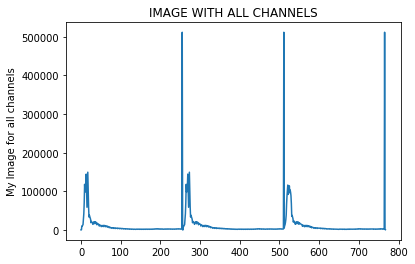

In [57]:
plt.plot(aHistgram)
plt.title('IMAGE WITH ALL CHANNELS')
plt.ylabel('My Image for all channels')
plt.show()

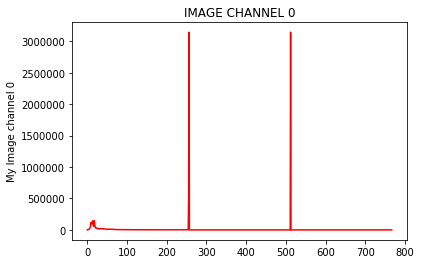

In [58]:
plt.plot(aHist_0, color='r')
plt.title('IMAGE CHANNEL 0')
plt.ylabel('My Image channel 0')
plt.show()

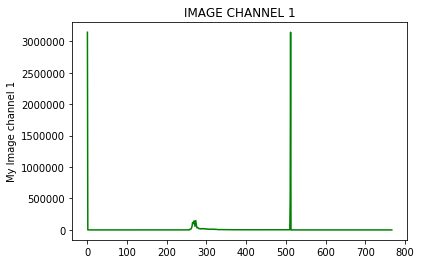

In [59]:
plt.plot(aHist_1, color='g')
plt.title('IMAGE CHANNEL 1')
plt.ylabel('My Image channel 1')
plt.show()

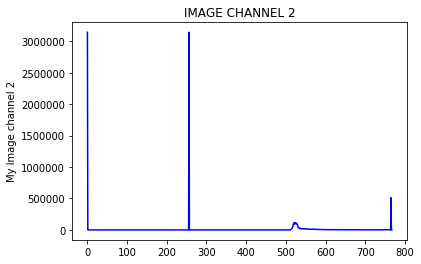

In [60]:
plt.plot(aHist_2, color='b')
plt.title('IMAGE CHANNEL 2')
plt.ylabel('My Image channel 2')
plt.show()

<Figure size 432x288 with 0 Axes>

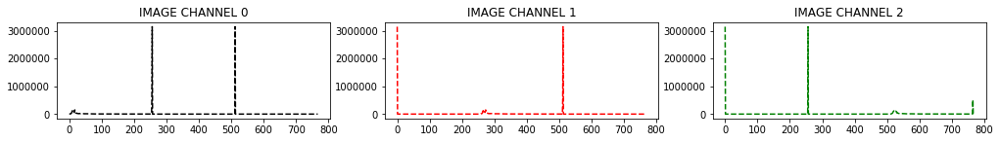

In [61]:
plt.figure(1)
plt.figure(figsize=(17, 4))
plt.tight_layout()
plt.subplot(231)
plt.title('IMAGE CHANNEL 0')
plt.plot(aHist_0,   'k--')

plt.subplot(232)
plt.title('IMAGE CHANNEL 1')
plt.plot(aHist_1,  'r--')

plt.subplot(233)
plt.title('IMAGE CHANNEL 2')
plt.plot(aHist_2,  'g--' )
plt.show()

In [62]:
## Using Matplotlib

In [63]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

In [64]:
# Read in the image and print some stats
file1 = f1_alum
image = mpimg.imread(file1)
print(f1_alum, '   This image is: ',type(image), 
     'with dimensions:', image.shape)

Aluminum_1.TIF    This image is:  <class 'numpy.ndarray'> with dimensions: (1536, 2048, 3)


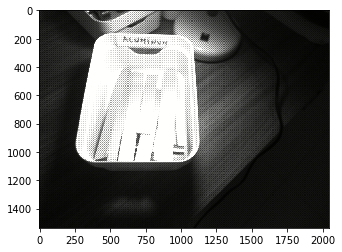

In [65]:
# Plotting the image

imgplot=plt.imshow(image)
plt.show()# Using Matplotlib to plot the Image

In [66]:
#splitting the image 
print(file1.split()) 

['Aluminum_1.TIF']


In [67]:
bFile = file1.split()
bFile

['Aluminum_1.TIF']

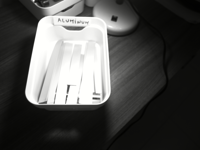

In [68]:
#In-place modification 
cFile = cImage.thumbnail((200, 200)) 
cImage

In [69]:
print(tiff.mode) 
          
#converting image to bitmap 
print(tiff.tobitmap()) 
          
print(type(tiff.tobitmap()) )

NameError: name 'tiff' is not defined

In [71]:
# Transform image in an array
import numpy as np
imarray = np.array(image)

In [75]:
# Information array image
imarray.shape

(1536, 2048, 3)

In [76]:
# Information array image
image.size

9437184

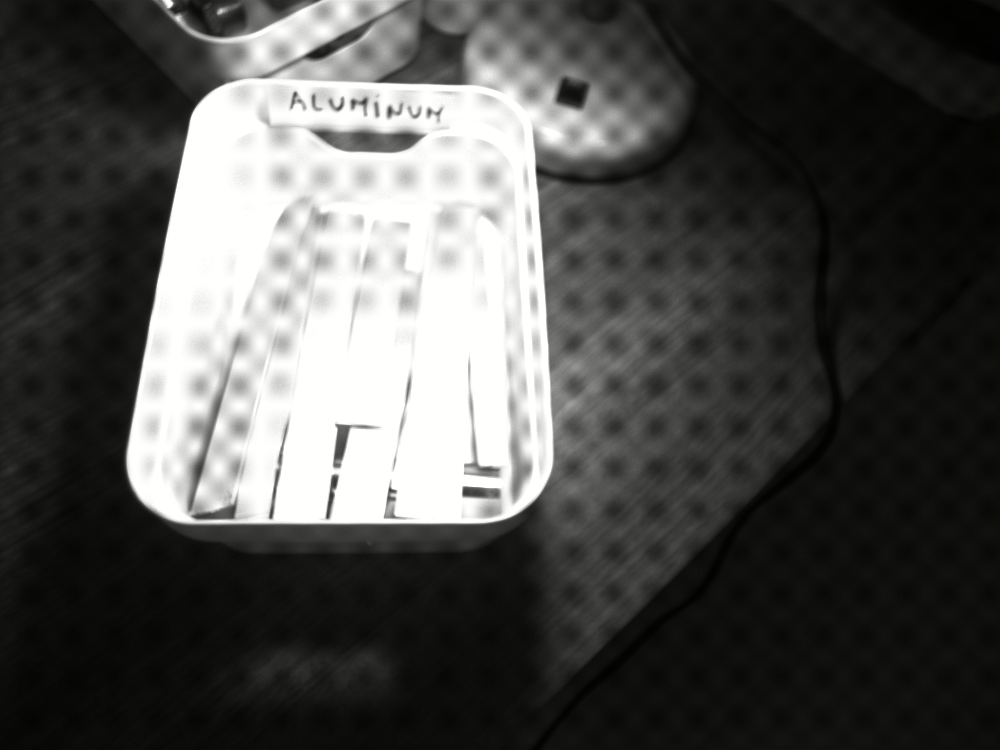

In [77]:
Image.fromarray(imarray)

In [83]:
from PIL import Image, ImageFile
import string


In [92]:
from PIL import Image, ImageFilter
try:
    original = Image.open(file1)
except:
    print ("Unable to load image")


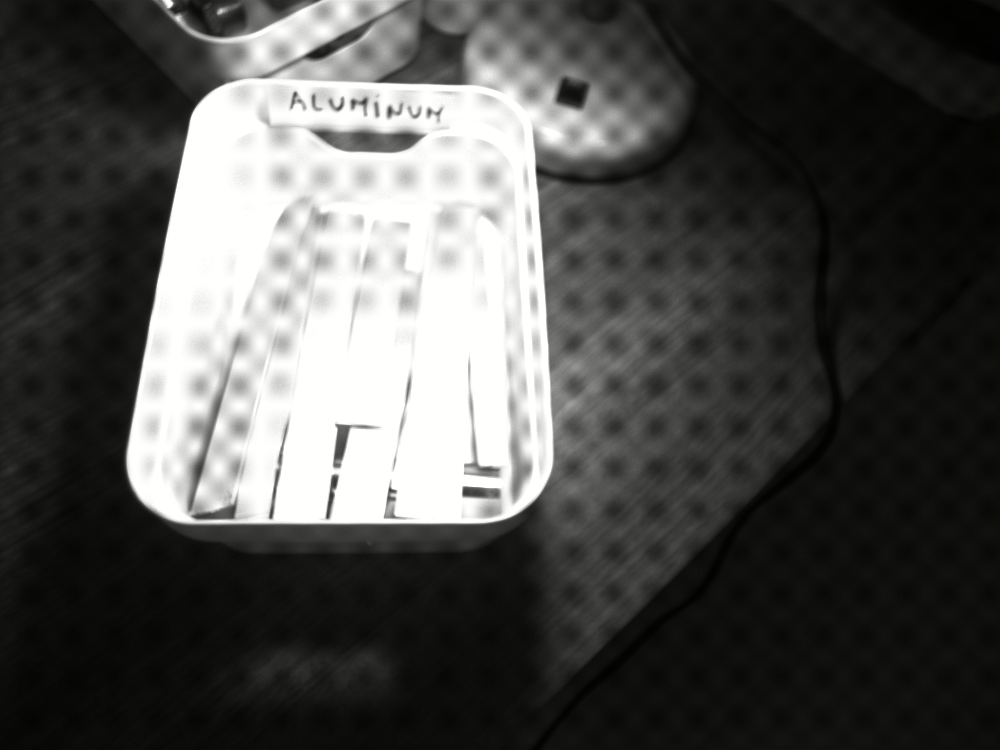

In [93]:
original

In [95]:
print ("The size of the Image is: ")
print(original.format, original.size, original.mode)

The size of the Image is: 
TIFF (2048, 1536) RGB


In [124]:
# https://www.pythonforbeginners.com/gui/how-to-use-pillow
# The Pillow module provides the following set of predefined image enhancement filters:

# BLUR
# CONTOUR
# DETAIL
# EDGE_ENHANCE
# EDGE_ENHANCE_MORE
# EMBOSS
# FIND_EDGES
# SMOOTH
# SMOOTH_MORE
# SHARPEN

In [97]:
# Blur the image
blurred = original.filter(ImageFilter.BLUR)

# Display both images
original.show()

blurred.show()

# save the new image
blurred.save("blurred.png")

In [99]:
# Creating Thumbnails
size = (128, 128)
saved = file1
try:
    im =  Image.open(file1)
except:
    print ("Unable to load image")

im.thumbnail(size)
im.save(saved)
im.show()

In [121]:
# Filter SMOOTH the image
filter_im = original.filter(ImageFilter.SMOOTH_MORE)

#filgter_im.show()

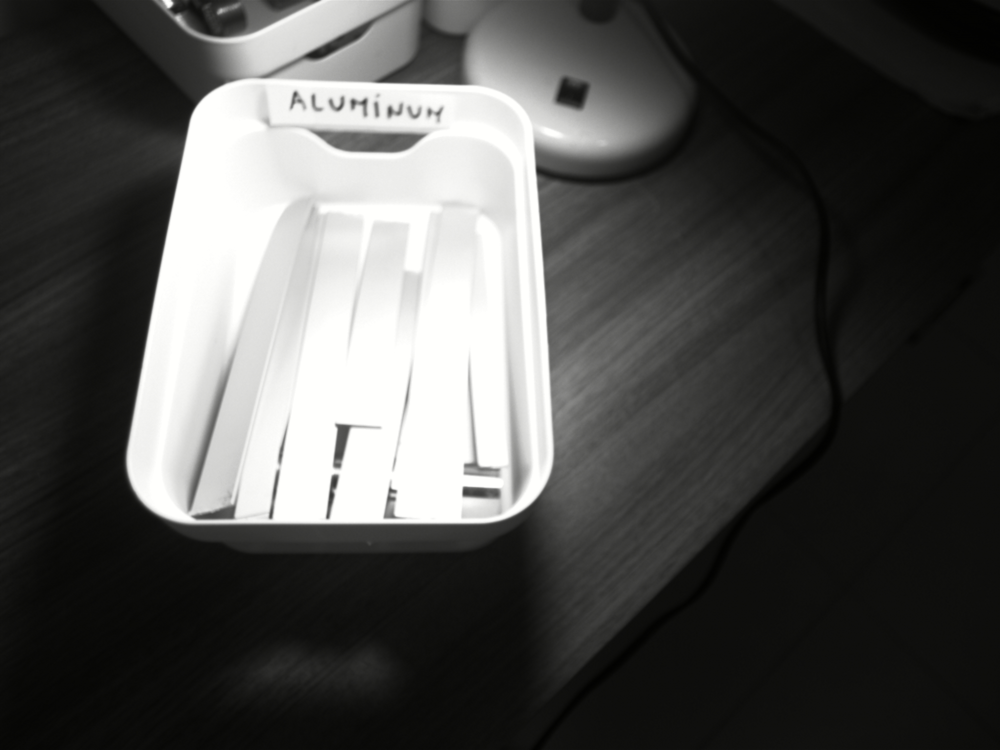

In [123]:
filter_im

In [125]:
# Obtain R,G,B separately
r, g, b = filter_im.split()

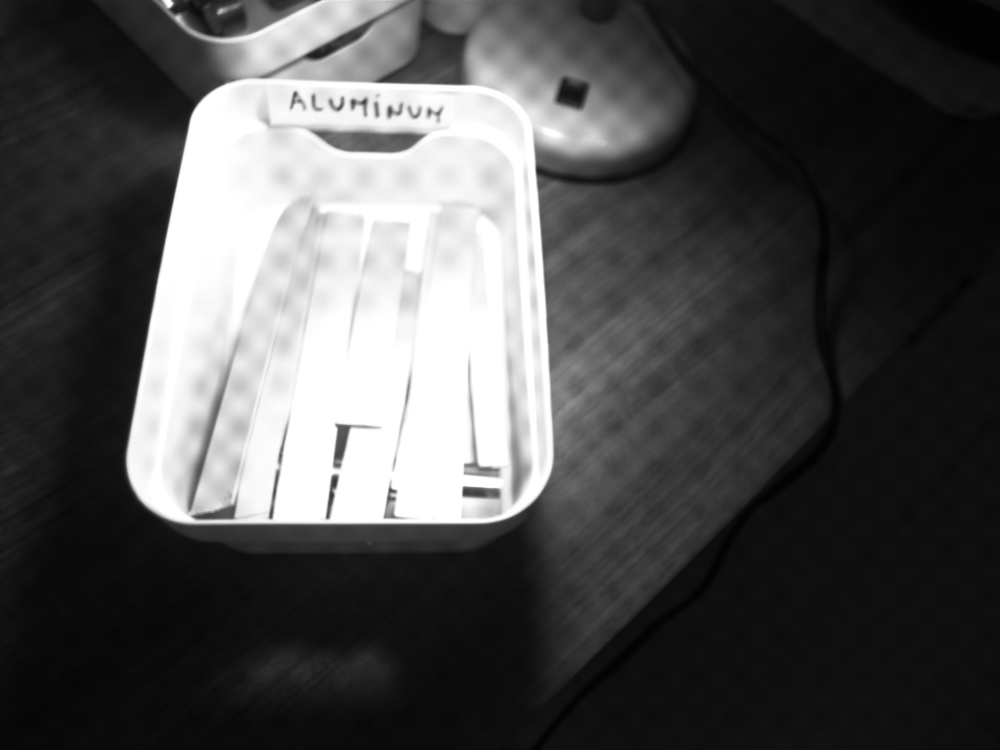

In [126]:
r

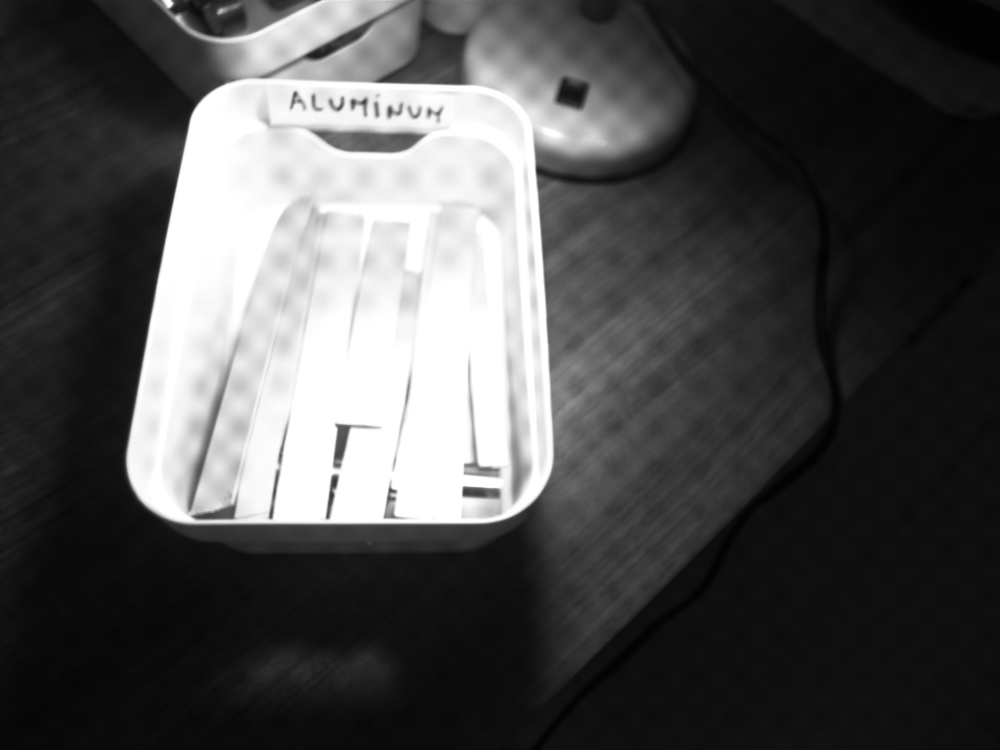

In [127]:
g

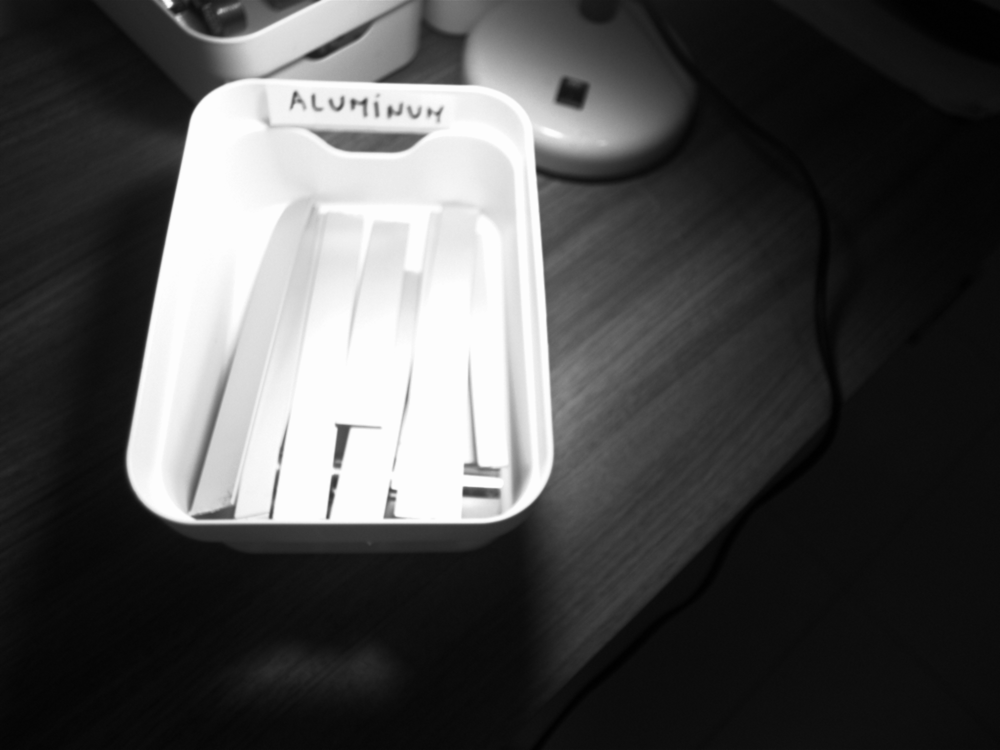

In [128]:
b

In [135]:
imarray = np.array(r)
imarray

array([[38, 29, 39, ..., 16, 21, 15],
       [20, 37, 20, ..., 18, 12, 20],
       [35, 27, 32, ..., 16, 21, 14],
       ...,
       [ 6,  8,  7, ..., 13,  7, 14],
       [ 9,  8,  9, ..., 10, 14, 11],
       [ 7, 10,  7, ..., 16, 11, 17]], dtype=uint8)

In [134]:
imarray = np.array(g)
imarray

array([[38, 29, 39, ..., 16, 21, 15],
       [20, 37, 20, ..., 18, 12, 20],
       [35, 27, 32, ..., 16, 21, 14],
       ...,
       [ 6,  8,  7, ..., 13,  7, 14],
       [ 9,  8,  9, ..., 10, 14, 11],
       [ 7, 10,  7, ..., 16, 11, 17]], dtype=uint8)

In [136]:
imarray = np.array(b)
imarray

array([[37, 28, 39, ..., 14, 18, 13],
       [18, 36, 20, ..., 15, 11, 18],
       [33, 26, 31, ..., 14, 21, 12],
       ...,
       [ 5,  6,  5, ..., 12,  6, 14],
       [ 9,  7,  8, ...,  7, 13,  9],
       [ 6,  8,  7, ..., 14,  8, 15]], dtype=uint8)

In [137]:
# Convert into modes
im = Image.open(file1).convert("L")

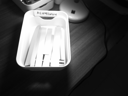

In [138]:
im

In [139]:
print(im.format, im.size, im.mode)

None (128, 96) L


In [155]:
# split the image into individual bands
source = filter_im.split()

R, G, B = 0, 1, 2

# select regions where red is less than 100
mask = source[R].point(lambda i: i < 100 and 255)

# process the green band
out = source[G].point(lambda i: i * 0.7)

# paste the processed band back, but only where red was < 100
b = source[G].paste(out, None, mask)

# build a new multiband image
im = Image.merge(filter_im.mode, source)

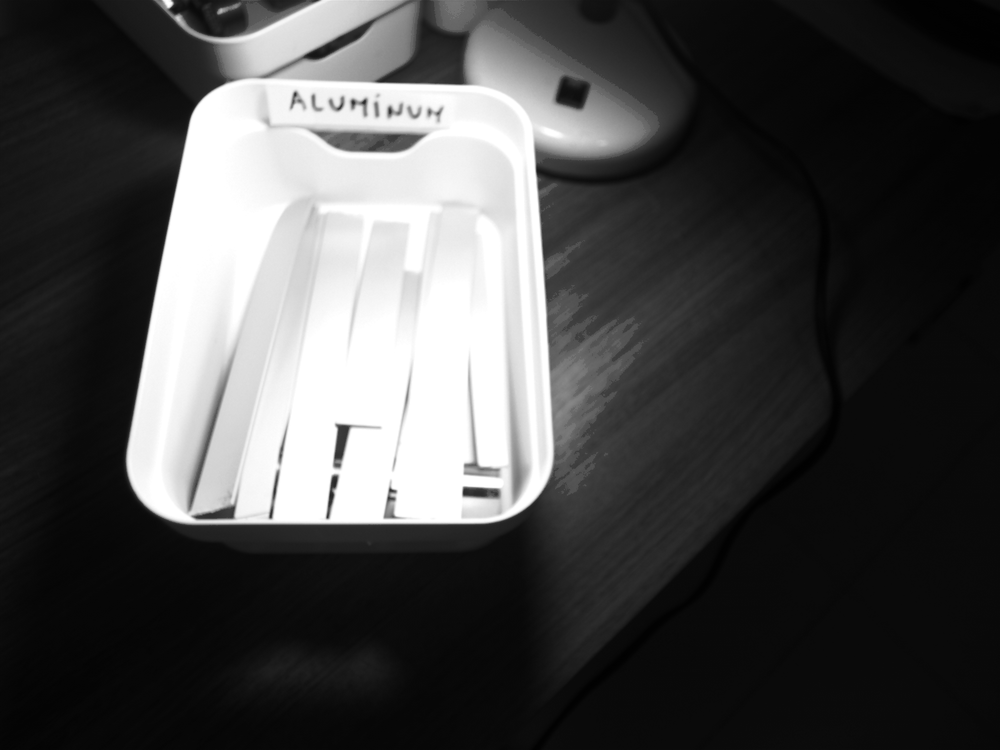

In [157]:
source[G]

In [158]:
# Enhancing images

In [159]:
from PIL import ImageEnhance

enh = ImageEnhance.Contrast(im)
enh.enhance(1.3).show("30% more contrast")

In [42]:
# Verify my current folder
currDir = os.path.dirname(os.path.realpath("__file__"))
mypath = currDir
print(currDir)  

C:\Users\manuel.robalinho\Google Drive\UPT_Portucalense\Trabalho final\Classificacao Sucata\Jupyter_Notebook\imagedata03


In [ ]:
# Path to the image files
#folder = "imagedata03"
#path = currDir + "/" + folder + "/"

In [50]:
from PIL import Image

xfile = mypath + '\Copper_2.jpg'

im = Image.open(xfile) # Can be many different formats.
pix = im.load()
print (im.size)  # Get the width and hight of the image for iterating over
print (pix[100,100])  # Get the RGBA Value of the a pixel of an image
#pix[x,y] = value  # Set the RGBA Value of the image (tuple)

im.save('alive_parrot.png')  # Save the modified pixels as .png

(5312, 2988)
(229, 234, 237)


In [61]:
from PIL import Image
img = Image.open(xfile)
colors = img.convert('RGB').getcolors() #this converts the mode to RGB

In [62]:
print(colors)

None


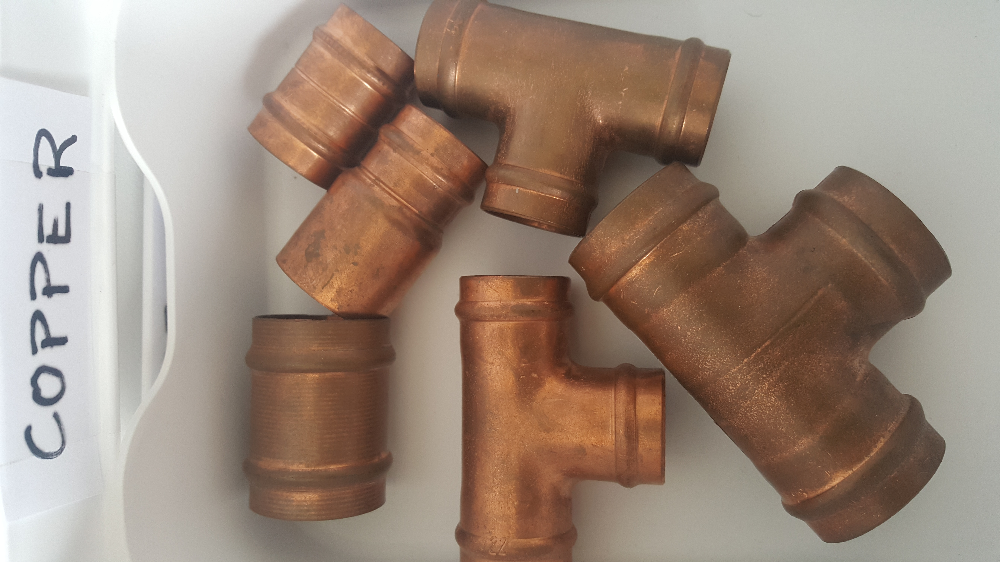

In [63]:
img

In [104]:
from PIL import Image
# https://www.hackerearth.com/pt-br/practice/notes/extracting-pixel-values-of-an-image-in-python/

# getdata() to extract the pixel values. this scans the image horizontally from left to right starting at
# the top-left corner. The values got from each pixel is then added into a list.
# Finally what we get is a list with each pixel value as a set of 4 values(R,G,B.A).

pix_val = list(im.getdata())

In [71]:
pix_val

[(232, 237, 240),
 (231, 236, 239),
 (234, 239, 242),
 (235, 240, 243),
 (233, 241, 243),
 (233, 241, 243),
 (230, 238, 240),
 (226, 234, 236),
 (224, 233, 232),
 (222, 231, 230),
 (224, 233, 232),
 (224, 233, 232),
 (228, 237, 236),
 (228, 237, 236),
 (229, 238, 237),
 (224, 233, 232),
 (226, 235, 234),
 (227, 236, 235),
 (229, 235, 235),
 (227, 233, 233),
 (227, 232, 235),
 (229, 234, 237),
 (230, 235, 238),
 (229, 234, 237),
 (224, 232, 234),
 (225, 233, 235),
 (226, 234, 236),
 (227, 235, 237),
 (228, 237, 236),
 (231, 237, 237),
 (229, 235, 235),
 (228, 234, 234),
 (228, 234, 234),
 (225, 231, 231),
 (228, 234, 234),
 (227, 233, 233),
 (227, 233, 233),
 (229, 235, 235),
 (227, 233, 233),
 (226, 232, 232),
 (228, 233, 236),
 (222, 227, 230),
 (226, 231, 234),
 (229, 234, 237),
 (229, 234, 237),
 (227, 232, 235),
 (223, 228, 231),
 (228, 233, 236),
 (225, 233, 235),
 (224, 232, 234),
 (228, 236, 238),
 (228, 236, 238),
 (228, 237, 236),
 (229, 238, 237),
 (228, 237, 236),
 (229, 235

In [81]:
type(pix_val)

list

In [97]:
# https://www.hackerearth.com/pt-br/practice/notes/extracting-pixel-values-of-an-image-in-python/
    
# pix_val is the list that contains all the pixel values which can be printed to see those values 
# But the list got is a list of sets and some times its needed to flatten the list for example if the 
# list is like: [(123,124,145,120), (345,453,234,124),……] 
# and the list that is needed is [123, 124, 145, 120, 345, 453, 234, 124….] then the command to flatten the list is:

pix_val_flat = [x for sets in pix_val for x in sets]

In [100]:
pix_val_flat

[232,
 237,
 240,
 231,
 236,
 239,
 234,
 239,
 242,
 235,
 240,
 243,
 233,
 241,
 243,
 233,
 241,
 243,
 230,
 238,
 240,
 226,
 234,
 236,
 224,
 233,
 232,
 222,
 231,
 230,
 224,
 233,
 232,
 224,
 233,
 232,
 228,
 237,
 236,
 228,
 237,
 236,
 229,
 238,
 237,
 224,
 233,
 232,
 226,
 235,
 234,
 227,
 236,
 235,
 229,
 235,
 235,
 227,
 233,
 233,
 227,
 232,
 235,
 229,
 234,
 237,
 230,
 235,
 238,
 229,
 234,
 237,
 224,
 232,
 234,
 225,
 233,
 235,
 226,
 234,
 236,
 227,
 235,
 237,
 228,
 237,
 236,
 231,
 237,
 237,
 229,
 235,
 235,
 228,
 234,
 234,
 228,
 234,
 234,
 225,
 231,
 231,
 228,
 234,
 234,
 227,
 233,
 233,
 227,
 233,
 233,
 229,
 235,
 235,
 227,
 233,
 233,
 226,
 232,
 232,
 228,
 233,
 236,
 222,
 227,
 230,
 226,
 231,
 234,
 229,
 234,
 237,
 229,
 234,
 237,
 227,
 232,
 235,
 223,
 228,
 231,
 228,
 233,
 236,
 225,
 233,
 235,
 224,
 232,
 234,
 228,
 236,
 238,
 228,
 236,
 238,
 228,
 237,
 236,
 229,
 238,
 237,
 228,
 237,
 236,
 229,
 235

In [102]:
# Sum the list
xx = sum(pix_val_flat)

# https://convertingcolors.com/decimal-color-139.5525.html
# medium color
yy = xx / len(pix_val_flat)

In [103]:
yy

139.55254235230748

In [139]:
# Name colors
# http://www.discoveryplayground.com/computer-programming-for-kids/rgb-colors/
# https://matplotlib.org/examples/color/named_colors.html

In [132]:
# https://matplotlib.org/gallery/color/named_colors.html
# Python from color name to RGB
from matplotlib import colors

print(colors.to_rgba('blue'))

(0.0, 0.0, 1.0, 1.0)


In [137]:
# https://matplotlib.org/2.0.0/examples/color/named_colors.html
from matplotlib import colors as mcolors


colors = dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS)

# Sort colors by hue, saturation, value and name.
by_hsv = sorted((tuple(mcolors.rgb_to_hsv(mcolors.to_rgba(color)[:3])), name)
                for name, color in colors.items())
sorted_names = [name for hsv, name in by_hsv]


In [136]:
colors

{'b': (0, 0, 1),
 'g': (0, 0.5, 0),
 'r': (1, 0, 0),
 'c': (0, 0.75, 0.75),
 'm': (0.75, 0, 0.75),
 'y': (0.75, 0.75, 0),
 'k': (0, 0, 0),
 'w': (1, 1, 1),
 'aliceblue': '#F0F8FF',
 'antiquewhite': '#FAEBD7',
 'aqua': '#00FFFF',
 'aquamarine': '#7FFFD4',
 'azure': '#F0FFFF',
 'beige': '#F5F5DC',
 'bisque': '#FFE4C4',
 'black': '#000000',
 'blanchedalmond': '#FFEBCD',
 'blue': '#0000FF',
 'blueviolet': '#8A2BE2',
 'brown': '#A52A2A',
 'burlywood': '#DEB887',
 'cadetblue': '#5F9EA0',
 'chartreuse': '#7FFF00',
 'chocolate': '#D2691E',
 'coral': '#FF7F50',
 'cornflowerblue': '#6495ED',
 'cornsilk': '#FFF8DC',
 'crimson': '#DC143C',
 'cyan': '#00FFFF',
 'darkblue': '#00008B',
 'darkcyan': '#008B8B',
 'darkgoldenrod': '#B8860B',
 'darkgray': '#A9A9A9',
 'darkgreen': '#006400',
 'darkgrey': '#A9A9A9',
 'darkkhaki': '#BDB76B',
 'darkmagenta': '#8B008B',
 'darkolivegreen': '#556B2F',
 'darkorange': '#FF8C00',
 'darkorchid': '#9932CC',
 'darkred': '#8B0000',
 'darksalmon': '#E9967A',
 'darkseagr